<a href="https://colab.research.google.com/github/vatiza/Machine_Learning/blob/main/Armed_Conflict_Analysis_Bangladesh_DRAFT2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Datasets/Armed_conflict_2001-01-01-2021-11-01-South_Asia-Bangladesh.csv')

In [ ]:
df.sample(n=2)

In [ ]:
df.columns

Index(['data_id', 'iso', 'event_id_cnty', 'event_id_no_cnty', 'event_date',
       'year', 'time_precision', 'event_type', 'sub_event_type', 'actor1',
       'assoc_actor_1', 'inter1', 'actor2', 'assoc_actor_2', 'inter2',
       'interaction', 'region', 'country', 'admin1', 'admin2', 'admin3',
       'location', 'latitude', 'longitude', 'geo_precision', 'source',
       'source_scale', 'notes', 'fatalities', 'timestamp', 'iso3'],
      dtype='object')

In [ ]:
not_useful_columns =['data_id', 'iso', 'event_id_cnty', 'event_id_no_cnty',
                     'time_precision', 'country', 'geo_precision', 'notes', 'timestamp',
                     'iso3']
df.drop(columns=not_useful_columns, inplace=True)

In [ ]:
df.sample(2)

,event_date,year,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,...,region,admin1,admin2,admin3,location,latitude,longitude,source,source_scale,fatalities
7722,10 April 2013,2013,Battles,Armed clash,Mariamnagar Communal Militia (Bangladesh),NaN,4,Mariamnagar Communal Militia (Bangladesh),NaN,4,...,South Asia,Chittagong,Chittagong,Rangunia,Rangunia,22.4755,92.0813,United News of Bangladesh,National,0
12158,15 August 2010,2010,Explosions/Remote violence,Grenade,Unidentified Armed Group (Bangladesh),NaN,3,Civilians (Bangladesh),AL: Bangladesh Awami League,7,...,South Asia,Khulna,Jhenaidah,Jhenaidah Sadar,Jhenaidah,23.5425,89.1749,Daily Star (Bangladesh),National,0


In [ ]:
df = df.replace(np.nan, "unknown")

In [ ]:
df.sample(2)

,event_date,year,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,...,region,admin1,admin2,admin3,location,latitude,longitude,source,source_scale,fatalities
5331,20 September 2014,2014,Battles,Armed clash,BCL: Bangladesh Chhatra League,unknown,3,BCL: Bangladesh Chhatra League,unknown,3,...,South Asia,Sylhet,Sylhet,Golapganj,Golapganj,24.8572,92.0138,Financial Express (Bangladesh),National,0
7120,15 August 2013,2013,Riots,Mob violence,Rioters (Bangladesh),BNP: Bangladesh Nationalist Party,5,Rioters (Bangladesh),AL: Bangladesh Awami League,5,...,South Asia,Rajshahi,Rajshahi,Bagmara,Baghmara,24.5900,88.8200,New Nation (Bangladesh),National,0


In [ ]:
from datetime import datetime
month=[]

for date_str in df['event_date']:
  date_object = datetime.strptime(date_str, '%d %B %Y').date()
  month.append(date_object.month)

df['month']=month
df.drop(columns=['event_date'],inplace=True)

In [ ]:
df.sample(2)

,year,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,interaction,...,admin1,admin2,admin3,location,latitude,longitude,source,source_scale,fatalities,month
2452,2018,Riots,Mob violence,Rioters (Bangladesh),unknown,5,Civilians (Bangladesh),AL: Bangladesh Awami League,7,57,...,Chittagong,Comilla,Burichang,Burichang,23.5534,91.1290,United News of Bangladesh,National,0,10
7333,2013,Battles,Armed clash,Sadhukhali Communal Militia (Bangladesh),unknown,4,Sadhukhali Communal Militia (Bangladesh),unknown,4,44,...,Khulna,Jhenaidah,Shailkupa,Sadhukhali,23.6726,89.1396,United News of Bangladesh,National,1,7


In [ ]:
my_column = df.pop('month')
df.insert(1, 'month', my_column)
df.sample(2)

,year,month,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,...,region,admin1,admin2,admin3,location,latitude,longitude,source,source_scale,fatalities
1882,2019,1,Riots,Mob violence,Rioters (Bangladesh),Kishoreganj Communal Group (Bangladesh),5,Rioters (Bangladesh),Kishoreganj Communal Group (Bangladesh),5,...,South Asia,Dhaka,Kishoregonj,Kishoreganj Sadar,Kishoreganj,24.4394,90.7829,New Nation (Bangladesh),National,1
9238,2012,5,Riots,Mob violence,Rioters (Bangladesh),Jagir Dighulia Communal Group (Bangladesh),5,Rioters (Bangladesh),Jagir Dighulia Communal Group (Bangladesh),5,...,South Asia,Dhaka,Manikganj,Manikgonj Sadar,Jaigir Dighalia,23.8589,90.1005,United News of Bangladesh,National,0


In [ ]:
# for simplicity let me drop more columns
# The plan is to find the clusters
# First cluster based on event_type, actor1
# Second cluster admin1(administritative area 1), event_type

In [ ]:
fc = df.loc[:,['event_type','actor1']]
fc.head()

,event_type,actor1
0,Violence against civilians,Police Forces of Bangladesh (2009-)
1,Riots,Rioters (Bangladesh)
2,Riots,Rioters (Bangladesh)
3,Riots,Rioters (Bangladesh)
4,Riots,Rioters (Bangladesh)


In [ ]:
! pip install kmodes

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from kmodes.kmodes import KModes

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 10043.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 10043.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 0, cost: 10043.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 0, cost: 10043.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 0, cost: 10043.0
Best run was number 1
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 3375, cost: 5349.0
Run 1, iteration: 2/100, moves: 1, cost: 5349.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 10043.0
Init: initializing centro

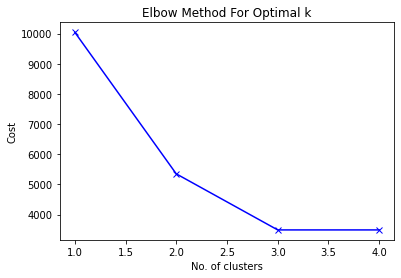

In [ ]:
#Elbow method to detect number of K
# https://github.com/tech-data/cutomer-segmentation/blob/main/Customer%20Segmentation-Kprototypes.ipynb
# https://www.analyticsvidhya.com/blog/2021/06/kmodes-clustering-algorithm-for-categorical-data/

fcdf = fc.to_numpy()

# Elbow curve to find optimal K
cost = []
K = range(1,5)
for num_clusters in list(K):
    kmode = KModes(n_clusters=num_clusters, init = "random", n_init = 5, verbose=1)
    kmode.fit_predict(fcdf)
    cost.append(kmode.cost_)

plt.plot(K, cost, 'bx-')
plt.xlabel('No. of clusters')
plt.ylabel('Cost')
plt.title('Elbow Method For Optimal k')
plt.show()

In [ ]:
# Building the model with 3 clusters
kmode = KModes(n_clusters=3, init = "random", n_init = 5, verbose=1)
clusters = kmode.fit_predict(fcdf)
clusters

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 3369, cost: 5349.0
Run 1, iteration: 2/100, moves: 7, cost: 5349.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 1612, cost: 4613.0
Run 2, iteration: 2/100, moves: 1, cost: 4613.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 0, cost: 5349.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 0, cost: 4895.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 0, cost: 10043.0
Best run was number 2


array([2, 0, 0, ..., 0, 1, 1], dtype=uint16)

In [ ]:
fc.insert(0, "Cluster", clusters, True)
fc

,Cluster,event_type,actor1
0,2,Violence against civilians,Police Forces of Bangladesh (2009-)
1,0,Riots,Rioters (Bangladesh)
2,0,Riots,Rioters (Bangladesh)
3,0,Riots,Rioters (Bangladesh)
4,0,Riots,Rioters (Bangladesh)
...,...,...,...
13378,0,Riots,Rioters (Bangladesh)
13379,0,Riots,Rioters (Bangladesh)
13380,0,Riots,Rioters (Bangladesh)
13381,1,Battles,BCL: Bangladesh Chhatra League


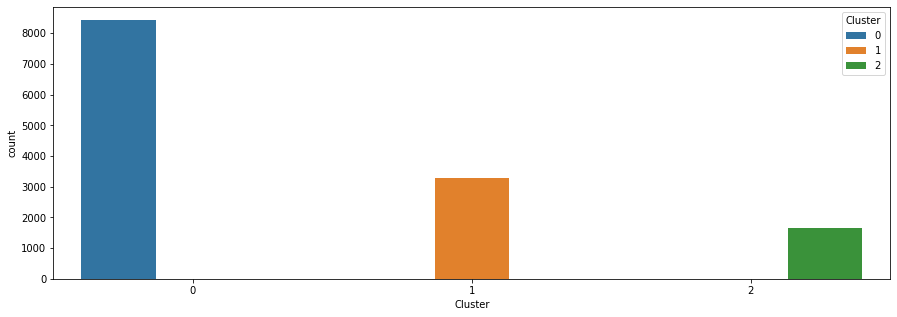

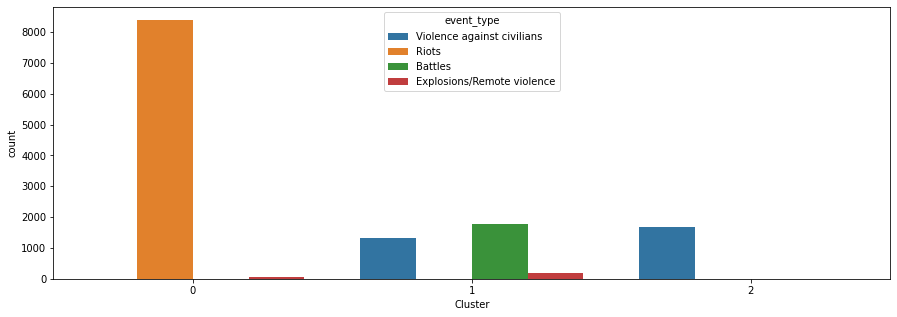

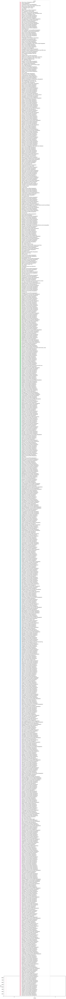

In [ ]:
# https://www.kaggle.com/code/teejmahal20/clustering-categorical-data-k-modes-cat-ii
import seaborn as sns
for col in fc.columns:
    plt.subplots(figsize = (15,5))
    sns.countplot(x='Cluster',hue=col, data = fc)
    plt.show()

In [ ]:
# Investing the second clusrer based on event_type and area
sc = df.loc[:,['event_type','admin1']]

In [ ]:
sc.sample(5)

,event_type,admin1
4790,Riots,Chittagong
6061,Violence against civilians,Rajshahi
5626,Battles,Khulna
9122,Violence against civilians,Dhaka
7509,Riots,Dhaka


Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 14712.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 14712.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 0, cost: 14712.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 0, cost: 14712.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 0, cost: 14712.0
Best run was number 1
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 1777, cost: 12171.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 2125, cost: 12587.0
Init: initializing centroids
Init: initializing clusters
Starting ite

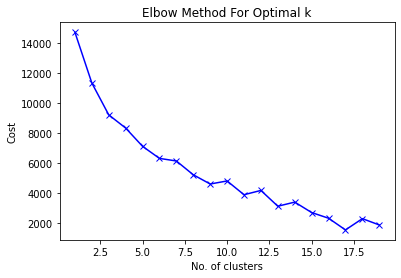

In [ ]:
scdf = sc.to_numpy()

# Elbow curve to find optimal K
cost = []
K = range(1,20)
for num_clusters in list(K):
    kmode = KModes(n_clusters=num_clusters, init = "random", n_init = 5, verbose=1)
    kmode.fit_predict(scdf)
    cost.append(kmode.cost_)

plt.plot(K, cost, 'bx-')
plt.xlabel('No. of clusters')
plt.ylabel('Cost')
plt.title('Elbow Method For Optimal k')
plt.show()

In [ ]:
# Building the model with 3 clusters
kmode = KModes(n_clusters=13, init = "random", n_init = 5, verbose=1)
clusters = kmode.fit_predict(scdf)
clusters

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 940, cost: 4815.0
Run 1, iteration: 2/100, moves: 0, cost: 4815.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 1571, cost: 4182.0
Run 2, iteration: 2/100, moves: 0, cost: 4182.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 3976, cost: 4949.0
Run 3, iteration: 2/100, moves: 0, cost: 4949.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 3063, cost: 2715.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 1960, cost: 3346.0
Best run was number 4


array([ 4, 10,  0, ...,  7,  5,  1], dtype=uint16)

In [ ]:
sc.insert(0, "Cluster", clusters, True)
sc

,Cluster,event_type,admin1
0,4,Violence against civilians,Rangpur
1,10,Riots,Rangpur
2,0,Riots,Barisal
3,0,Riots,Mymensingh
4,7,Riots,Khulna
...,...,...,...
13378,7,Riots,Khulna
13379,7,Riots,Khulna
13380,7,Riots,Khulna
13381,5,Battles,Rajshahi


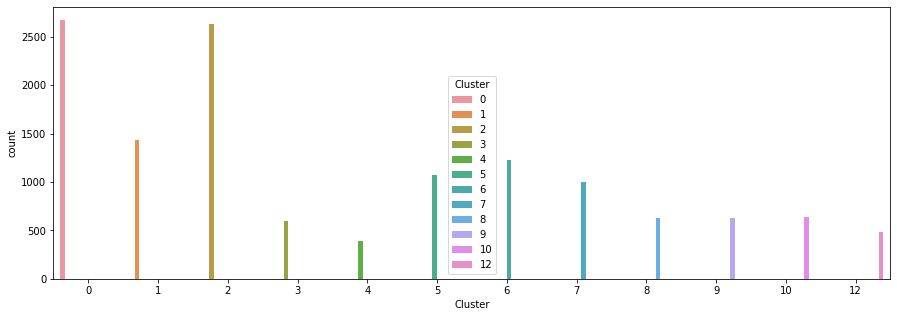

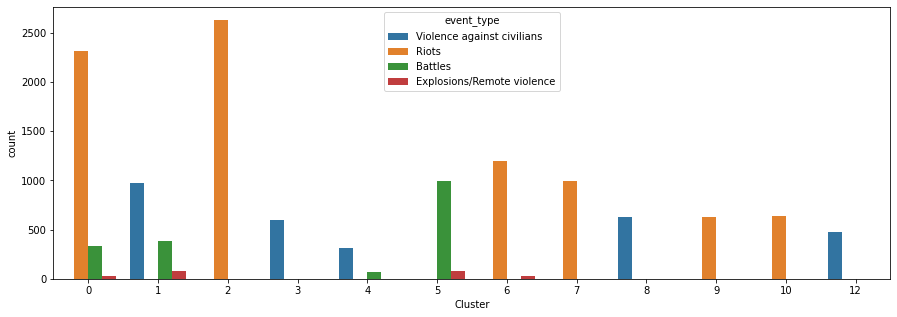

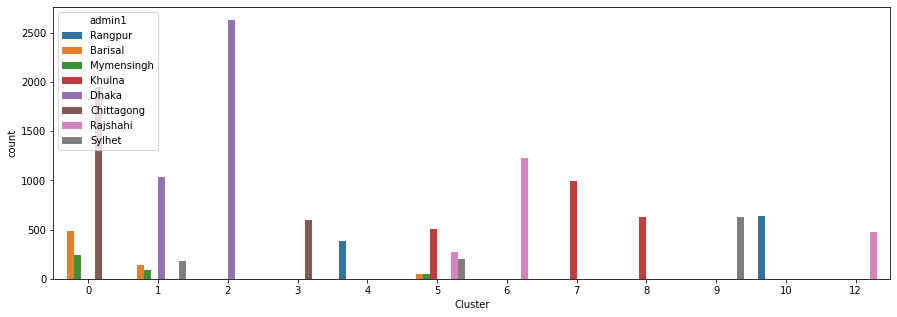

In [ ]:
import seaborn as sns
for col in sc.columns:
    plt.subplots(figsize = (15,5))
    sns.countplot(x='Cluster',hue=col, data = sc)
    plt.show()

In [ ]:
df.sample(5)

,year,month,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,...,region,admin1,admin2,admin3,location,latitude,longitude,source,source_scale,fatalities
7238,2013,7,Violence against civilians,Attack,AL: Bangladesh Awami League,unknown,3,Civilians (Bangladesh),JSD: Jatiya Samajtantrik Dal,7,...,South Asia,Barisal,Barisal,Banari Para,Banaripara,22.7893,90.1722,Daily Star (Bangladesh),National,1
11390,2011,1,Violence against civilians,Attack,Unidentified Armed Group (Bangladesh),unknown,3,Civilians (Bangladesh),JJD: Jatiyatabadi Jubo Dal,7,...,South Asia,Dhaka,Dhaka,Motijheel,Dhaka - Motijheel,23.7363,90.4183,Bangladesh Government News,Other,1
3441,2016,3,Riots,Mob violence,Rioters (Bangladesh),unknown,5,Rioters (Bangladesh),unknown,5,...,South Asia,Dhaka,Kishoregonj,Kishoreganj Sadar,Kishoreganj,24.4394,90.7829,New Nation (Bangladesh),National,1
294,2021,6,Riots,Mob violence,Rioters (Bangladesh),AL: Bangladesh Awami League,5,Rioters (Bangladesh),AL: Bangladesh Awami League,5,...,South Asia,Dhaka,Shariatpur,Naria,Naria,23.3029,90.4087,Prothom Alo,National,0
12500,2010,6,Violence against civilians,Attack,Police Forces of India (2004-2014) Border Secu...,unknown,8,Civilians (Bangladesh),Cattle Traders (Bangladesh),7,...,South Asia,Rajshahi,Naogaon,Dhamoirhat,Dhamoirhat,25.1504,88.8834,Daily Star (Bangladesh),National,1


When visualizing the clusters made by the K-Modes algorithm, it's important to keep in mind that the data is categorical. Here are some ways you can visualize the clusters:

Cluster sizes: You can create a bar chart or a pie chart showing the number of instances in each cluster. This will give you an idea of how many instances belong to each cluster and how balanced or imbalanced the clusters are.

Cluster profiles: You can create a stacked bar chart or a heatmap showing the distribution of the categorical variables within each cluster. This will give you an idea of how the categorical variables differ between the clusters.

Pairwise distance matrix: You can create a matrix plot showing the pairwise distances between the instances. This will give you an idea of how similar or dissimilar the instances are to each other, and you can use colors to show the cluster assignments.

t-SNE plot: You can use t-SNE (t-Distributed Stochastic Neighbor Embedding) to create a 2D plot that visualizes the high-dimensional data in a lower-dimensional space. You can use colors to show the cluster assignments, and this will give you an idea of how well the algorithm has separated the instances into distinct clusters.

Parallel coordinates plot: You can use a parallel coordinates plot to visualize the distribution of the categorical variables within each cluster. This will give you an idea of how the variables differ between the clusters and how the instances within each cluster are similar or dissimilar to each other.

Sankey diagram: You can use a Sankey diagram to visualize the flow of instances between the categorical variables within each cluster. This will give you an idea of the most common transitions between the variables within each cluster and how the instances within each cluster are related to each other.


/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


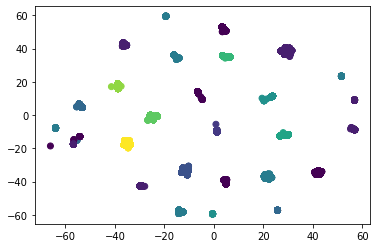

In [ ]:
import pandas as pd
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Load the dataset
df = sc

# Select the categorical columns to use for clustering
cat_columns = ['event_type', 'admin1']

# Convert the categorical data to one-hot encoded representation
one_hot_df = pd.get_dummies(df[cat_columns])

# Create a t-SNE model with two components
tsne = TSNE(n_components=2, random_state=42)

# Fit the t-SNE model to the one-hot encoded data
tsne_data = tsne.fit_transform(one_hot_df)

# Plot the data points with colors representing the original labels
plt.scatter(tsne_data[:, 0], tsne_data[:, 1], c=df['Cluster'])
plt.show()


In [ ]:
# The following code and answer added from ChatGPT
# In this updated example, we first fit a K-Means algorithm to the categorical
# columns in the dataset and get the cluster labels. We then convert the
# categorical data to a one-hot encoded representation, fit a t-SNE model to the
# encoded data, and transform the data to two dimensions. Finally, we plot the
# data points with colors representing the clusters and add labels for each point
# showing the cluster number. The plt.colorbar() function adds a colorbar to the
# plot to show the mapping of colors to cluster numbers.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


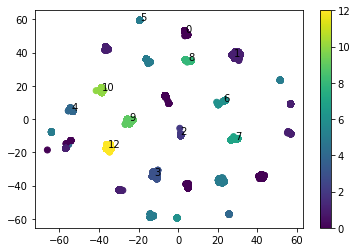

In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Load the dataset
df = sc

# Select the categorical columns to use for clustering
cat_columns = ['event_type', 'admin1']

# Fit the K-Modes algorithm to the data and get the cluster labels
# km = KMeans(n_clusters=5, random_state=42)
# clusters = km.fit_predict(df[cat_columns]) # already done in KMODES above

# Convert the categorical data to one-hot encoded representation
one_hot_df = pd.get_dummies(df[cat_columns])

# Create a t-SNE model with two components
tsne = TSNE(n_components=2, random_state=42)

# Fit the t-SNE model to the one-hot encoded data
tsne_data = tsne.fit_transform(one_hot_df)

# Plot the data points with colors representing the clusters
plt.scatter(tsne_data[:, 0], tsne_data[:, 1], c=clusters)
plt.colorbar()

# Add labels for each unique cluster label
unique_clusters = list(set(clusters))
for cluster in unique_clusters:
    # Get the index of the first data point in the cluster
    index = list(clusters).index(cluster)
    # Get the t-SNE coordinates of the data point
    tsne_coord = tsne_data[index]
    # Add the cluster label at the data point position
    plt.text(tsne_coord[0], tsne_coord[1], str(cluster), color='black')

plt.show()

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


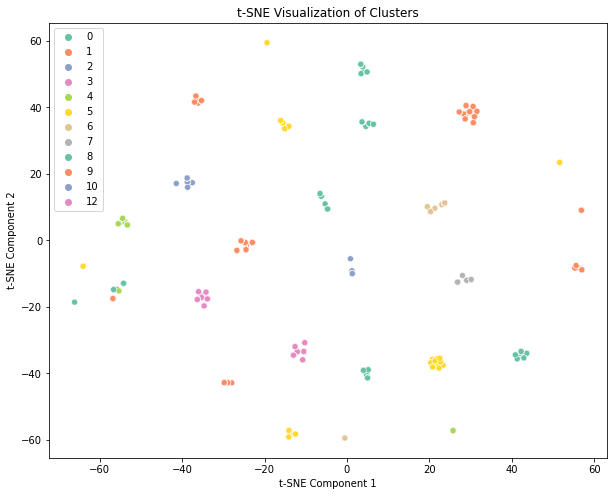

                         event_type      admin1
cluster                                        
0                             Riots  Chittagong
1        Violence against civilians       Dhaka
2                             Riots       Dhaka
3        Violence against civilians  Chittagong
4        Violence against civilians     Rangpur
5                           Battles      Khulna
6                             Riots    Rajshahi
7                             Riots      Khulna
8        Violence against civilians      Khulna
9                             Riots      Sylhet
10                            Riots     Rangpur
12       Violence against civilians    Rajshahi


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE
from kmodes.kmodes import KModes

# Load the data
df = sc

# Set the categorical columns
cat_columns = ['event_type', 'admin1']

# Fit the K-Modes algorithm to the data and get the cluster labels
# km = KMeans(n_clusters=5, random_state=42)
# clusters = km.fit_predict(df[cat_columns]) # already done in KMODES above

# Convert the categorical data to one-hot encoded representation
one_hot_df = pd.get_dummies(df[cat_columns])
tsne = TSNE(n_components=2, perplexity=30, random_state=42)

# Fit the t-SNE model to the data
tsne_results = tsne.fit_transform(one_hot_df)

# Create a scatterplot of the t-SNE visualization with the data points colored by their cluster label
plt.figure(figsize=(10, 8))
sns.scatterplot(x=tsne_results[:, 0], y=tsne_results[:, 1], hue=clusters, palette="Set2")
plt.title("t-SNE Visualization of Clusters")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.show()

# Create a table of the characteristics of the data points in each cluster
df_clustered = df.copy()
df_clustered["cluster"] = clusters
cluster_table = df_clustered.groupby("cluster").agg({col: lambda x: x.value_counts().index[0] for col in cat_columns})
print(cluster_table)


In [ ]:
df.sample(n=5)

,year,month,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,...,region,admin1,admin2,admin3,location,latitude,longitude,source,source_scale,fatalities
4134,2015,3,Explosions/Remote violence,Remote explosive/landmine/IED,BNP: Bangladesh Nationalist Party,unknown,3,Civilians (Bangladesh),Government of Bangladesh (2009-),7,...,South Asia,Dhaka,Dhaka,unknown,Dhaka,23.7104,90.4074,United News of Bangladesh,National,0
9444,2012,3,Riots,Mob violence,Rioters (Bangladesh),BNP: Bangladesh Nationalist Party,5,Rioters (Bangladesh),BNP: Bangladesh Nationalist Party; AL: Banglad...,5,...,South Asia,Rajshahi,Pabna,Santhia,Santhia,24.0532,89.5623,United News of Bangladesh,National,0
8576,2012,11,Riots,Violent demonstration,Rioters (Bangladesh),JeI: Jamaat-e-Islami; ICS: Islami Chhatra Shib...,5,Police Forces of Bangladesh (2009-),unknown,1,...,South Asia,Dhaka,Dhaka,unknown,Dhaka,23.7104,90.4074,South Asia Terrorism Portal,Other,0
1155,2020,1,Riots,Mob violence,Rioters (Bangladesh),AL: Bangladesh Awami League,5,Rioters (Bangladesh),AL: Bangladesh Awami League,5,...,South Asia,Rajshahi,Pabna,Sujanagar,Ahmmadpur,23.9517,89.5839,New Age (Bangladesh),National,0
2187,2018,12,Riots,Mob violence,Rioters (Bangladesh),unknown,5,Civilians (Bangladesh),BNP: Bangladesh Nationalist Party; JJD: Jatiya...,7,...,South Asia,Khulna,Jhenaidah,Kaliganj,Kaliganj,23.4096,89.1380,Dhaka Tribune,National,0


In [ ]:
df['actor1'].value_counts()[0:25]

Rioters (Bangladesh)                                                         8332
Unidentified Armed Group (Bangladesh)                                        1714
AL: Bangladesh Awami League                                                   456
BCL: Bangladesh Chhatra League                                                388
Police Forces of India (2004-2014) Border Security Force                      270
Police Forces of Bangladesh (2009-)                                           168
Police Forces of India (2014-) Border Security Force                          139
BNP: Bangladesh Nationalist Party                                             129
Jubo League                                                                   126
JeI: Jamaat-e-Islami                                                          124
ICS: Islami Chhatra Shibir                                                     84
JCD: Bangladesh Jatiotabadi Chatra Dal                                         54
JMB: Jamaat-ul-M

In [ ]:
df['actor2'].value_counts()[0:25]

Civilians (Bangladesh)                                                       5352
Police Forces of Bangladesh (2009-)                                          2675
Rioters (Bangladesh)                                                         2614
unknown                                                                      1150
AL: Bangladesh Awami League                                                   226
BCL: Bangladesh Chhatra League                                                156
Police Forces of Bangladesh (2009-) Rapid Action Battalion                     96
BNP: Bangladesh Nationalist Party                                              81
Unidentified Armed Group (Bangladesh)                                          81
Jubo League                                                                    47
Police Forces of Bangladesh (2009-) Border Guards Bangladesh                   44
PBCP: Purba Banglar Communist Party                                            36
PBCP-ML(J): Purb

In [ ]:
df[df['fatalities']==df['fatalities'].max()]

,year,month,event_type,sub_event_type,actor1,assoc_actor_1,inter1,actor2,assoc_actor_2,inter2,...,region,admin1,admin2,admin3,location,latitude,longitude,source,source_scale,fatalities
3189,2016,7,Battles,Armed clash,Islamic State (Bangladesh),unknown,2,Police Forces of Bangladesh (2009-),unknown,1,...,South Asia,Dhaka,Dhaka,Gulshan,Dhaka - Gulshan,23.7897,90.4104,Xinhua; Financial Express (Bangladesh); Daily ...,National-International,28


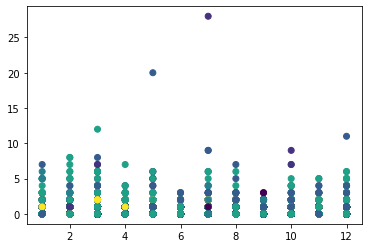

In [ ]:
plt.scatter(df['month'],df['fatalities'],c=df['inter1'])

And here is some sample code to cluster conflict types and actors involved using K-Means clustering:

In [ ]:
df.columns

Index(['year', 'month', 'event_type', 'sub_event_type', 'actor1',
       'assoc_actor_1', 'inter1', 'actor2', 'assoc_actor_2', 'inter2',
       'interaction', 'region', 'admin1', 'admin2', 'admin3', 'location',
       'latitude', 'longitude', 'source', 'source_scale', 'fatalities'],
      dtype='object')

In [ ]:
df['event_type'].value_counts()

Riots                         8391
Violence against civilians    2984
Battles                       1790
Explosions/Remote violence     218
Name: event_type, dtype: int64

In [ ]:
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.cluster import KMeans

# Load the dataset
data = df

# Encode categorical columns
encoder = OneHotEncoder()
encoded_data = encoder.fit_transform(data[['event_type', 'actor1']]).toarray()

# Perform clustering
kmeans = KMeans(n_clusters=4)
kmeans.fit(encoded_data, sample_weight=data['fatalities'])

# Get the cluster labels and cluster centers
labels = kmeans.labels_
centers = kmeans.cluster_centers_

# Analyze the distribution of conflict types and actor1s involved in each cluster
for i in range(len(centers)):
    cluster_indices = [j for j in range(len(labels)) if labels[j] == i]
    event_types = data.iloc[cluster_indices]['event_type'].value_counts()
    actor1s = data.iloc[cluster_indices]['actor1'].value_counts()
    print(f'Cluster {i}:')
    print(f'Conflict Types:\n{event_types}')
    print(f'actor1s Involved:\n{actor1s}')


Cluster 0:
Conflict Types:
Riots    8387
Name: event_type, dtype: int64
actor1s Involved:
Rioters (Bangladesh)                        8332
Police Forces of Bangladesh (2009-)           35
Rioters (Myanmar)                              9
AL: Bangladesh Awami League                    2
Rioters (China)                                1
Rioters (India)                                1
Kaldhar Communal Militia (Bangladesh)          1
Char Bonia Communal Militia (Bangladesh)       1
Kuttamara Communal Militia (Bangladesh)        1
ICS: Islami Chhatra Shibir                     1
BNP: Bangladesh Nationalist Party              1
HeI: Hefazat-e-Islam Bangladesh                1
Pirojipur Communal Militia (Bangladesh)        1
Name: actor1, dtype: int64
Cluster 1:
Conflict Types:
Violence against civilians    1666
Explosions/Remote violence       1
Name: event_type, dtype: int64
actor1s Involved:
Police Forces of India (2004-2014) Border Security Force    264
BCL: Bangladesh Chhatra League      

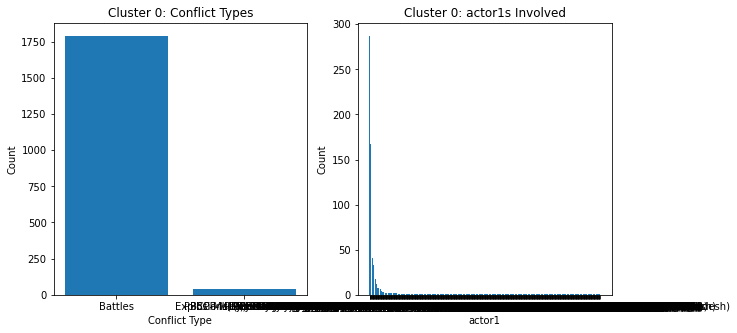

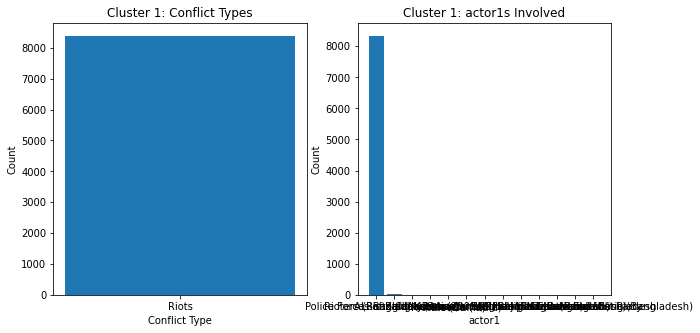

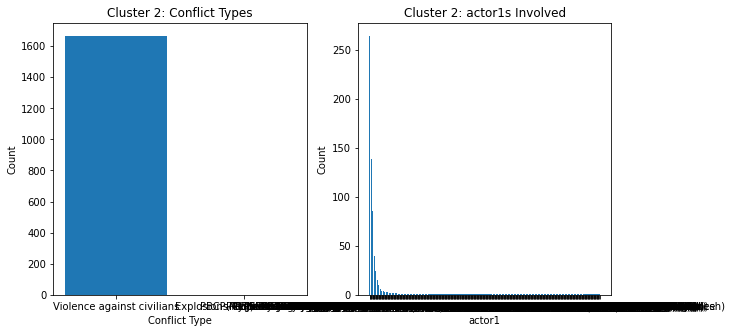

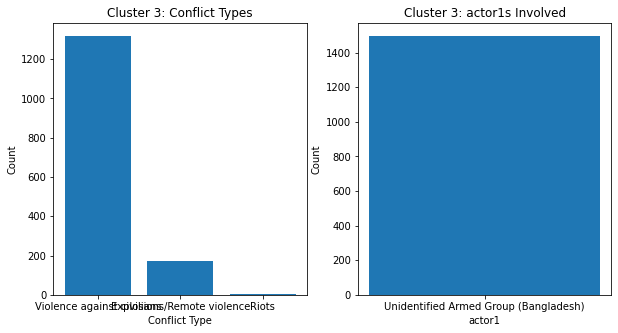

In [ ]:
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Load the dataset
data = df

# Encode categorical columns
encoder = OneHotEncoder()
encoded_data = encoder.fit_transform(data[['event_type', 'actor1']]).toarray()

# Perform clustering
kmeans = KMeans(n_clusters=4)
kmeans.fit(encoded_data, sample_weight=data['fatalities'])

# Get the cluster labels and cluster centers
labels = kmeans.labels_
centers = kmeans.cluster_centers_


# Visualize the clusters using a bar chart
for i in range(len(centers)):
    cluster_indices = [j for j in range(len(labels)) if labels[j] == i]
    event_types = data.iloc[cluster_indices]['event_type'].value_counts()
    actor1s = data.iloc[cluster_indices]['actor1'].value_counts()
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
    ax[0].bar(event_types.index, event_types.values)
    ax[0].set_title(f'Cluster {i}: Conflict Types')
    ax[0].set_xlabel('Conflict Type')
    ax[0].set_ylabel('Count')
    ax[1].bar(actor1s.index, actor1s.values)
    ax[1].set_title(f'Cluster {i}: actor1s Involved')
    ax[1].set_xlabel('actor1')
    ax[1].set_ylabel('Count')
    plt.show()


In [ ]:
# above analysis shows there are too much actors involved. Let me limit the actors.
# Count the number of occurrences for each actor
actor_counts = data['actor1'].value_counts()

# Filter the actors with less than 100 occurrences
other_actors = actor_counts[actor_counts < 100].index

# Replace the filtered actors with "others"
data.loc[data['actor1'].isin(other_actors), 'actor1'] = 'others'

In [ ]:
data['actor1'].value_counts()

Rioters (Bangladesh)                                        8332
Unidentified Armed Group (Bangladesh)                       1714
others                                                      1537
AL: Bangladesh Awami League                                  456
BCL: Bangladesh Chhatra League                               388
Police Forces of India (2004-2014) Border Security Force     270
Police Forces of Bangladesh (2009-)                          168
Police Forces of India (2014-) Border Security Force         139
BNP: Bangladesh Nationalist Party                            129
Jubo League                                                  126
JeI: Jamaat-e-Islami                                         124
Name: actor1, dtype: int64

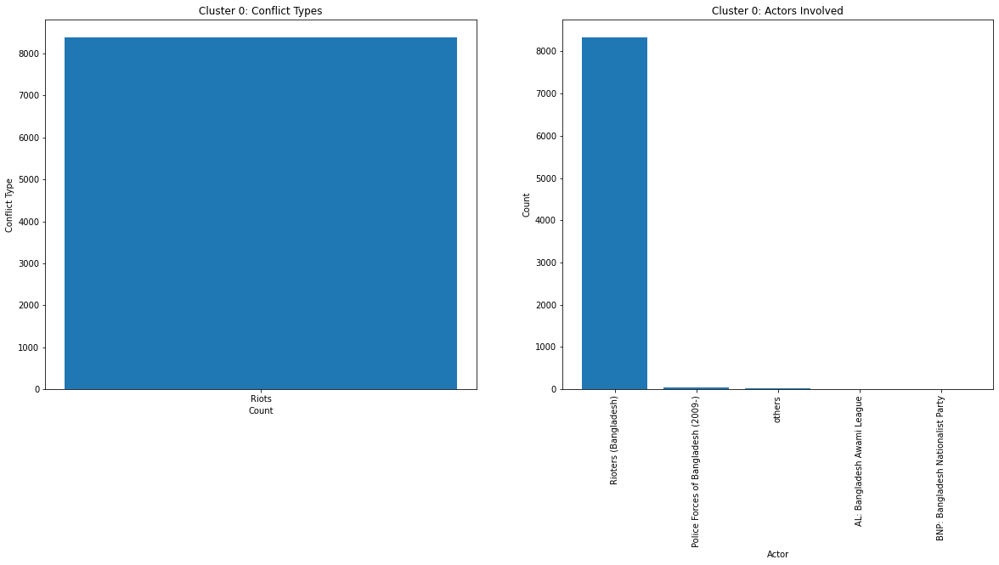

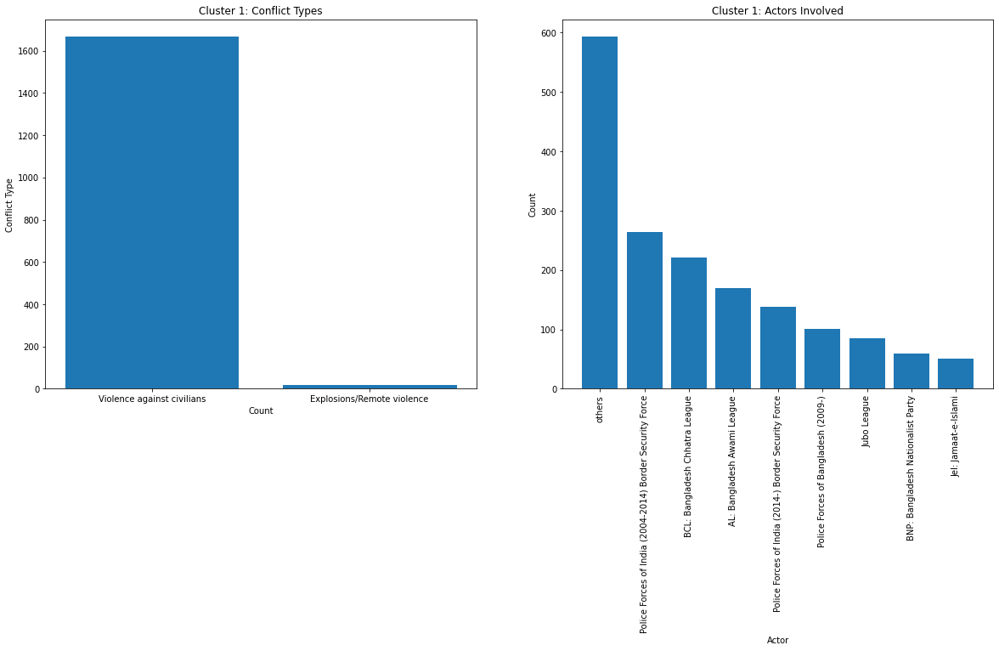

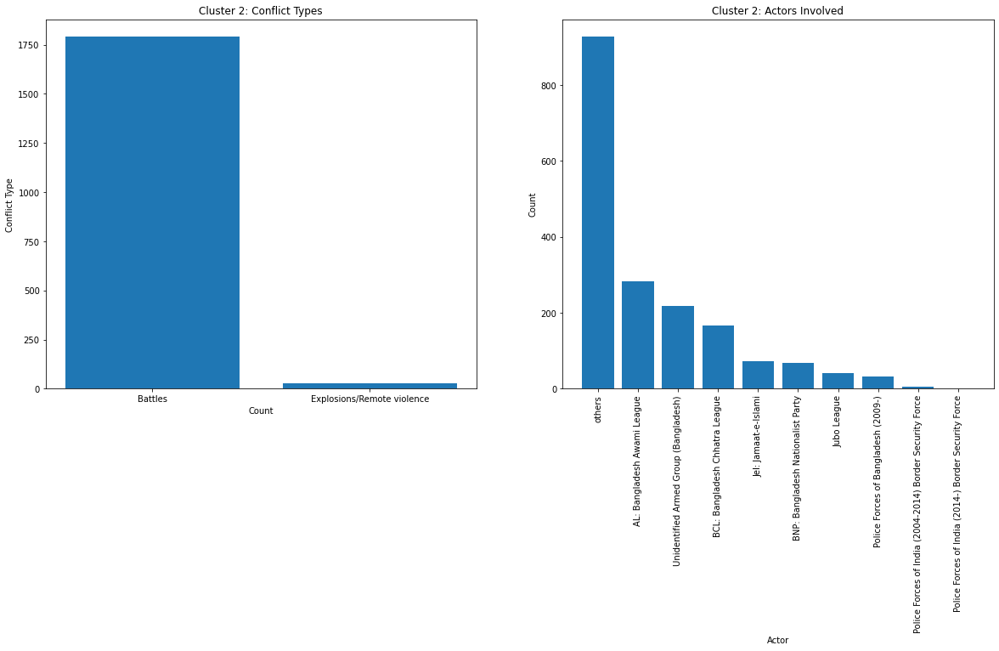

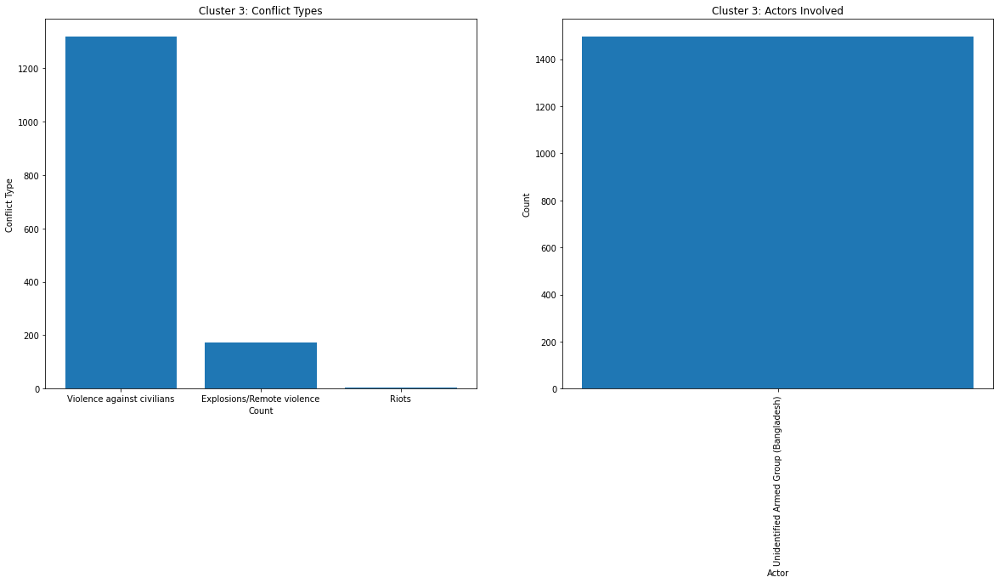

In [ ]:
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Load the dataset
data = df

# Encode categorical columns
encoder = OneHotEncoder()
encoded_data = encoder.fit_transform(data[['event_type', 'actor1']]).toarray()

# Perform clustering
kmeans = KMeans(n_clusters=4)
kmeans.fit(encoded_data, sample_weight=data['fatalities'])

# Get the cluster labels and cluster centers
labels = kmeans.labels_
centers = kmeans.cluster_centers_


# Visualize the clusters using a bar chart
for i in range(len(centers)):
    cluster_indices = [j for j in range(len(labels)) if labels[j] == i]
    event_types = data.iloc[cluster_indices]['event_type'].value_counts()
    actor1s = data.iloc[cluster_indices]['actor1'].value_counts()
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 8))
    ax[0].bar(event_types.index, event_types.values)
    ax[0].set_title(f'Cluster {i}: Conflict Types')
    ax[0].set_xlabel('Count')
    ax[0].set_ylabel('Conflict Type')
    ax[1].bar(actor1s.index, actor1s.values)
    ax[1].set_title(f'Cluster {i}: Actors Involved')
    ax[1].set_xlabel('Actor')
    ax[1].set_ylabel('Count')
    ax[1].set_xticklabels(actor1s.index, rotation=90)
    plt.subplots_adjust(hspace=0.5)
    plt.show()


####Here is some sample code to cluster the areas based on fatality rates using K-Means clustering:

In [ ]:
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.cluster import KMeans

# Load the dataset
data = df

# Encode categorical columns
encoder = OneHotEncoder()
encoded_data = encoder.fit_transform(data[['admin1', 'event_type', 'actor1']]).toarray()

# Perform clustering
kmeans = KMeans(n_clusters=5)
kmeans.fit(encoded_data, sample_weight=data['fatalities'])

# Get the cluster labels and cluster centers
labels = kmeans.labels_
centers = kmeans.cluster_centers_

# Calculate the mean fatalities rate for each cluster
fatality_rates = []
for i in range(len(centers)):
    cluster_indices = [j for j in range(len(labels)) if labels[j] == i]
    fatality_rates.append(sum(data.iloc[cluster_indices]['fatalities']) / len(cluster_indices))

# Identify the clusters with the highest fatalities rate
max_fatality_rate = max(fatality_rates)
high_fatality_clusters = [i for i in range(len(fatality_rates)) if fatality_rates[i] == max_fatality_rate]


IndexError: ignored

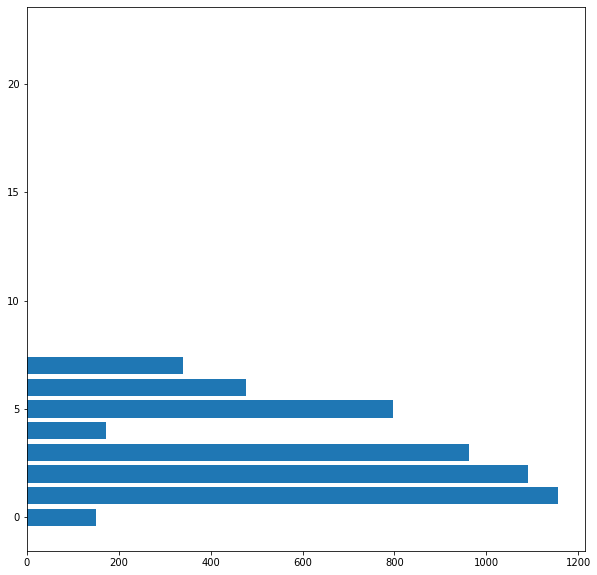

In [ ]:
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Load the dataset
data = df

# Encode categorical columns
encoder = OneHotEncoder()
encoded_data = encoder.fit_transform(data[['admin1', 'event_type', 'actor1']]).toarray()

# Perform clustering
kmeans = KMeans(n_clusters=23)
kmeans.fit(encoded_data, sample_weight=data['fatalities'])

# Get the cluster labels and cluster centers
labels = kmeans.labels_
centers = kmeans.cluster_centers_

# Get the fatalities for each admin1
admin1_fatalities = data.groupby('admin1')['fatalities'].sum()

# Get the top admin1s by fatalities
top_admin1s = admin1_fatalities.nlargest(8).index.tolist()

# Filter the data by the top admin1s
top_admin1_data = data[data['admin1'].isin(top_admin1s)]

# Group the data by admin1 and sum the fatality counts
cluster_fatalities = top_admin1_data.groupby('admin1')['fatalities'].sum().tolist()

# Reshape the cluster fatalities array to match the shape of the centers array
cluster_fatalities = [cluster_fatalities[i:i+len(encoder.categories_[0])] for i in range(0, len(cluster_fatalities), len(encoder.categories_[0]))]
cluster_fatalities = [list(x) + [0]*(len(centers[0])-len(x)) for x in cluster_fatalities]

# Visualize the clusters using a horizontal bar chart
fig, ax = plt.subplots(figsize=(10, 10))
ax.barh(range(len(centers)), cluster_fatalities[0])
ax.barh(range(len(centers)), cluster_fatalities[1], left=cluster_fatalities[0])
ax.barh(range(len(centers)), cluster_fatalities[2], left=[sum(x) for x in zip(cluster_fatalities[0], cluster_fatalities[1])])
ax.set_yticks(range(len(centers)))
ax.set_yticklabels([f'Cluster {i}' for i in range(len(centers))])
ax.set_xlabel('Fatalities')
ax.set_title('Clusters of Top Admin1s based on Fatality Rates')
plt.show()


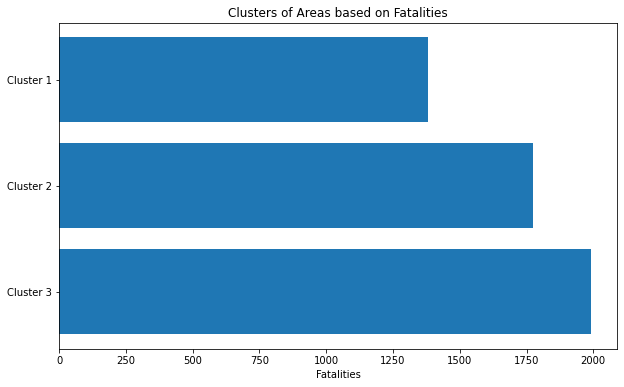

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the dataset
data = df

# Replace actor values less than 100 with 'Others'
data.loc[data['actor1'].value_counts()[data['actor1']].values < 100, 'actor1'] = 'Others'

# Select the relevant columns
X = data[['admin1', 'event_type', 'actor1', 'fatalities']]

# One-hot encode the categorical variables
X = pd.get_dummies(X, columns=['admin1', 'event_type', 'actor1'])

# Fit the KMeans model
kmeans = KMeans(n_clusters=3, random_state=0).fit(X)

# Get the cluster centers and their corresponding fatalities
cluster_centers = kmeans.cluster_centers_
cluster_labels = kmeans.labels_
cluster_fatalities = np.zeros(len(cluster_centers))

for i, label in enumerate(cluster_labels):
    cluster_fatalities[label] += data.iloc[i]['fatalities']

# Plot the results
fig, ax = plt.subplots(figsize=(10, 6))
ax.barh(range(len(cluster_centers)), cluster_fatalities)
ax.set_yticks(range(len(cluster_centers)))
ax.set_yticklabels(['Cluster {}'.format(i+1) for i in range(len(cluster_centers))])
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Fatalities')
ax.set_title('Clusters of Areas based on Fatalities')
plt.show()


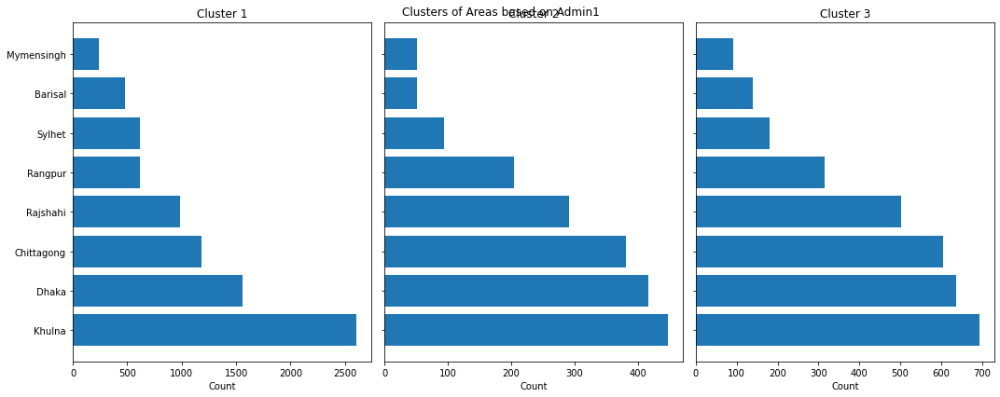

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the dataset
data = df

# Replace actor values less than 100 with 'Others'
data.loc[data['actor1'].value_counts()[data['actor1']].values < 100, 'actor1'] = 'Others'

# Select the relevant columns
X = data[['admin1', 'event_type', 'actor1', 'fatalities']]

# One-hot encode the categorical variables
X = pd.get_dummies(X, columns=['admin1', 'event_type', 'actor1'])

# Fit the KMeans model
kmeans = KMeans(n_clusters=3, random_state=0).fit(X)

# Get the cluster labels
cluster_labels = kmeans.labels_

# Plot the results for each cluster
fig, axs = plt.subplots(1, 3, figsize=(15, 6), sharey=True)
for i in range(3):
    # Get the data for the current cluster
    cluster_data = data.loc[cluster_labels == i, 'admin1'].value_counts().reset_index()
    cluster_data.columns = ['admin1', 'count']
    cluster_data = cluster_data.sort_values('count', ascending=False)

    # Plot the data for the current cluster
    axs[i].barh(cluster_data['admin1'], cluster_data['count'])
    axs[i].set_xlabel('Count')
    axs[i].set_title('Cluster {}'.format(i+1))
plt.suptitle('Clusters of Areas based on Admin1')
plt.tight_layout()
plt.show()


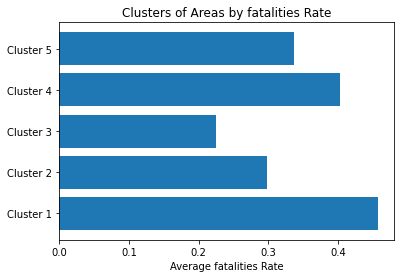

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load data from a CSV file
data = df

# Filter the data to only include the relevant columns
data = data[['admin1', 'fatalities']]

# Group the data by admin1 and compute the average fatalities rate for each area
grouped = data.groupby('admin1').mean()

# Normalize the data so that each feature has unit variance
X = (grouped - grouped.mean()) / grouped.std()

# Perform K-Means clustering with 5 clusters
kmeans = KMeans(n_clusters=5, random_state=42).fit(X)

# Add the cluster labels to the data frame
grouped['cluster'] = kmeans.labels_

# Compute the average fatalities rate for each cluster
cluster_fatalities = grouped.groupby('cluster').mean()

# Visualize the clusters in a bar chart
fig, ax = plt.subplots()
ax.barh(range(len(cluster_fatalities)), cluster_fatalities['fatalities'])
ax.set_yticks(range(len(cluster_fatalities)))
ax.set_yticklabels(['Cluster ' + str(i+1) for i in range(len(cluster_fatalities))])
ax.set_xlabel('Average fatalities Rate')
ax.set_title('Clusters of Areas by fatalities Rate')
plt.show()


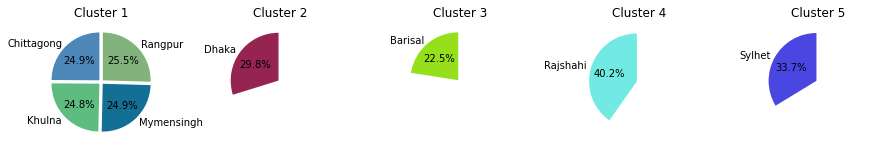

In [ ]:
# Visualize the areas in each cluster with the average fatality rate
fig, axes = plt.subplots(1, len(cluster_fatalities), figsize=(15,5))

for i, (cluster, data) in enumerate(grouped.groupby('cluster')):
    sizes = data['fatalities']
    labels = data.index
    explode = [0.05] * len(data)
    colors = np.random.rand(len(data),3)
    axes[i].pie(sizes, labels=labels, explode=explode, colors=colors, autopct='%1.1f%%', startangle=90)
    axes[i].set_aspect('equal')
    axes[i].set_title('Cluster ' + str(cluster+1))
    plt.subplots_adjust(wspace=0.5)

plt.show()


In [ ]:
df['admin1'].value_counts()

Dhaka         3663
Chittagong    2541
Khulna        2125
Rajshahi      1978
Rangpur       1022
Sylhet        1006
Barisal        670
Mymensingh     378
Name: admin1, dtype: int64

In [ ]:
# so founded the most affected areas based on fatality.

In [ ]:
# Next i will find the causes of fatalities in each cluster.
# also the actors involved in those clusters.

# Investigations

<ipython-input-72-f75b50aee024>:39: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


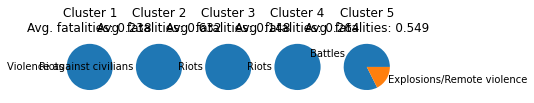

In [ ]:
from sklearn.cluster import KMeans
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
data = df

# Filter actors with less than 100 occurrences
actor_counts = data["actor1"].value_counts()
data = data[data["actor1"].isin(actor_counts[actor_counts >= 100].index)]

# Select relevant columns
data = data[['admin1', 'event_type', 'actor1', 'fatalities']]

# One-hot encode the categorical columns
data_encoded = pd.get_dummies(data, columns=['admin1', 'event_type', 'actor1'])

# Normalize the numerical columns
data_encoded["fatalities"] = (data_encoded["fatalities"] - data_encoded["fatalities"].min()) / (data_encoded["fatalities"].max() - data_encoded["fatalities"].min())

# Find clusters based on fatality rates
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(data_encoded)

# Assign clusters to each row in the original dataset
data["cluster"] = kmeans.labels_

# Calculate average fatality rate for each cluster
cluster_avg_fatalities = data.groupby("cluster")["fatalities"].mean()

# Display event types involved in each cluster
for i in range(5):
    cluster_data = data[data["cluster"] == i]
    event_type_counts = cluster_data["event_type"].value_counts(normalize=True)
    plt.subplot(1, 5, i+1)
    plt.pie(event_type_counts, labels=event_type_counts.index)
    plt.title(f"Cluster {i+1}\nAvg. fatalities: {cluster_avg_fatalities[i]:.3f}")
plt.tight_layout()
plt.show()


<ipython-input-74-cc64dfe7d093>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['fatalities_norm'] = np.log(data['fatalities'])


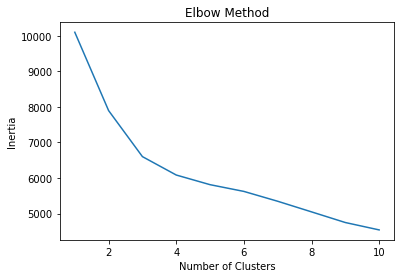

<ipython-input-74-cc64dfe7d093>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['cluster'] = kmeans.labels_


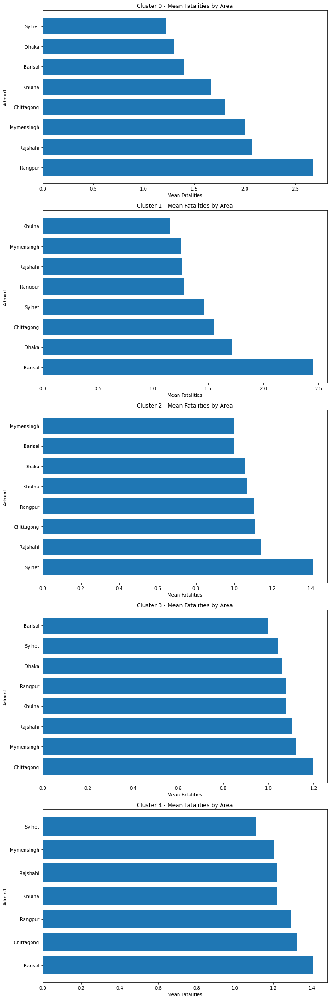

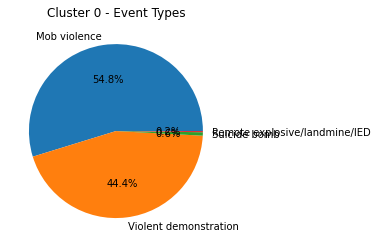

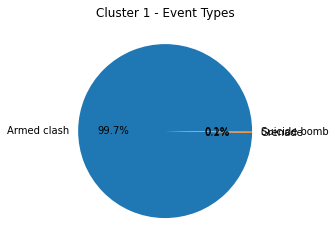

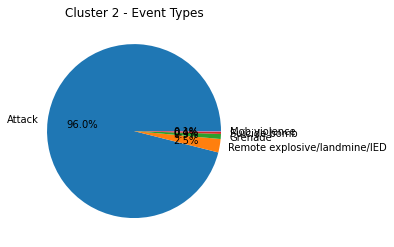

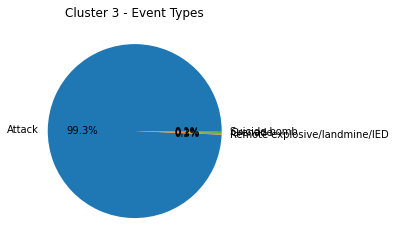

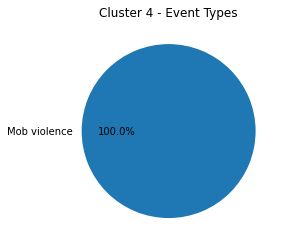

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the data
data = df

# Filter out areas with no fatalities
data = data[data['fatalities']>0]

# Normalize the fatalities column
data['fatalities_norm'] = np.log(data['fatalities'])

# Create a matrix with the normalized fatalities and categorical variables
X = pd.get_dummies(data[['admin1', 'sub_event_type', 'actor1']])
X['fatalities_norm'] = data['fatalities_norm']

# Find the optimal number of clusters using the elbow method
inertia = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(X)
    inertia.append(kmeans.inertia_)
plt.plot(range(1, 11), inertia)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.show()

# Fit KMeans with the chosen number of clusters
n_clusters = 5
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(X)

# Add the cluster labels to the original dataframe
data['cluster'] = kmeans.labels_

# Create a figure with a subplot for each cluster
fig, axs = plt.subplots(n_clusters, 1, figsize=(10, 6*n_clusters))

# Loop over the clusters and plot a bar chart of the mean fatalities for each area
for i in range(n_clusters):
    cluster_data = data[data['cluster']==i]
    cluster_fatalities = cluster_data.groupby('admin1')['fatalities'].mean().sort_values(ascending=False)
    axs[i].barh(range(len(cluster_fatalities)), cluster_fatalities.values)
    axs[i].set_yticks(range(len(cluster_fatalities)))
    axs[i].set_yticklabels(cluster_fatalities.index)
    axs[i].set_title('Cluster {} - Mean Fatalities by Area'.format(i))
    axs[i].set_xlabel('Mean Fatalities')
    axs[i].set_ylabel('Admin1')
plt.tight_layout()
plt.show()

# Loop over the clusters and plot a pie chart of the event types for each cluster
for i in range(n_clusters):
    cluster_data = data[data['cluster']==i]
    cluster_sub_event_types = cluster_data.groupby('sub_event_type').size().sort_values(ascending=False)
    plt.figure()
    plt.pie(cluster_sub_event_types.values, labels=cluster_sub_event_types.index, autopct='%1.1f%%')
    plt.title('Cluster {} - Event Types'.format(i))
plt.show()


<ipython-input-76-2b9e7b4cd5f6>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['fatalities_norm'] = np.log(data['fatalities'])


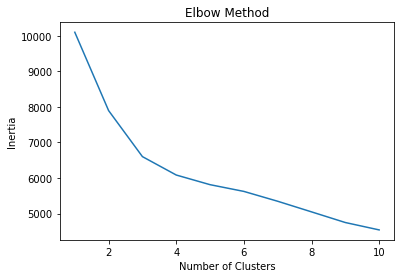

<ipython-input-76-2b9e7b4cd5f6>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['cluster'] = kmeans.labels_


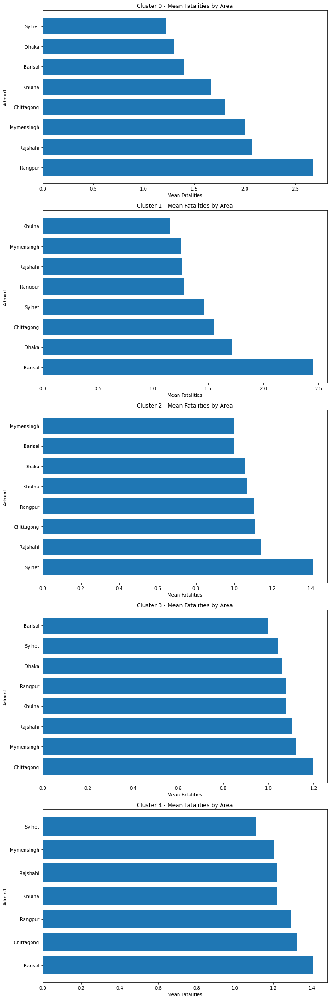

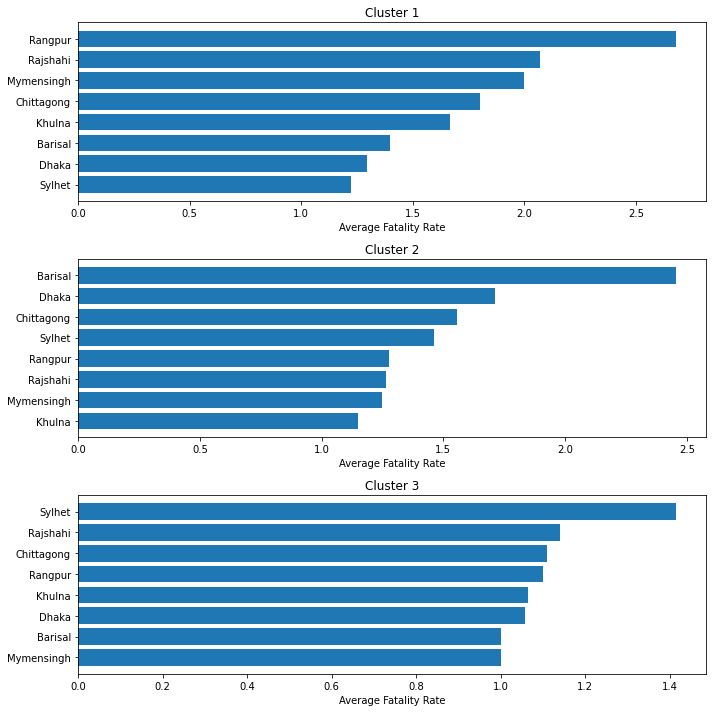

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the data
data = df

# Filter out areas with no fatalities
data = data[data['fatalities']>0]

# Normalize the fatalities column
data['fatalities_norm'] = np.log(data['fatalities'])

# Create a matrix with the normalized fatalities and categorical variables
X = pd.get_dummies(data[['admin1', 'sub_event_type', 'actor1']])
X['fatalities_norm'] = data['fatalities_norm']

# Find the optimal number of clusters using the elbow method
inertia = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(X)
    inertia.append(kmeans.inertia_)
plt.plot(range(1, 11), inertia)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.show()

# Fit KMeans with the chosen number of clusters
n_clusters = 5
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(X)

# Add the cluster labels to the original dataframe
data['cluster'] = kmeans.labels_

# Create a figure with a subplot for each cluster
fig, axs = plt.subplots(n_clusters, 1, figsize=(10, 6*n_clusters))

# Loop over the clusters and plot a bar chart of the mean fatalities for each area
for i in range(n_clusters):
    cluster_data = data[data['cluster']==i]
    cluster_fatalities = cluster_data.groupby('admin1')['fatalities'].mean().sort_values(ascending=False)
    axs[i].barh(range(len(cluster_fatalities)), cluster_fatalities.values)
    axs[i].set_yticks(range(len(cluster_fatalities)))
    axs[i].set_yticklabels(cluster_fatalities.index)
    axs[i].set_title('Cluster {} - Mean Fatalities by Area'.format(i))
    axs[i].set_xlabel('Mean Fatalities')
    axs[i].set_ylabel('Admin1')
plt.tight_layout()
plt.show()


# set up the subplots
fig, axes = plt.subplots(nrows=len(cluster_centers), figsize=(10, 10))

# loop through each cluster center
for i, center in enumerate(cluster_centers):

    # filter the data for this cluster
    cluster_mask = kmeans.labels_ == i
    cluster_data = data[cluster_mask]

    # get the average fatality rate for each admin1 area
    admin1_data = cluster_data.groupby('admin1')['fatalities'].mean()
    admin1_data = admin1_data.sort_values(ascending=False)[:10]

    # plot the bar chart
    ax = axes[i]
    ax.barh(range(len(admin1_data)), admin1_data.values)
    ax.set_yticks(range(len(admin1_data)))
    ax.set_yticklabels(admin1_data.index)
    ax.invert_yaxis()
    ax.set_title(f'Cluster {i+1}')
    ax.set_xlabel('Average Fatality Rate')

plt.tight_layout()
plt.show()


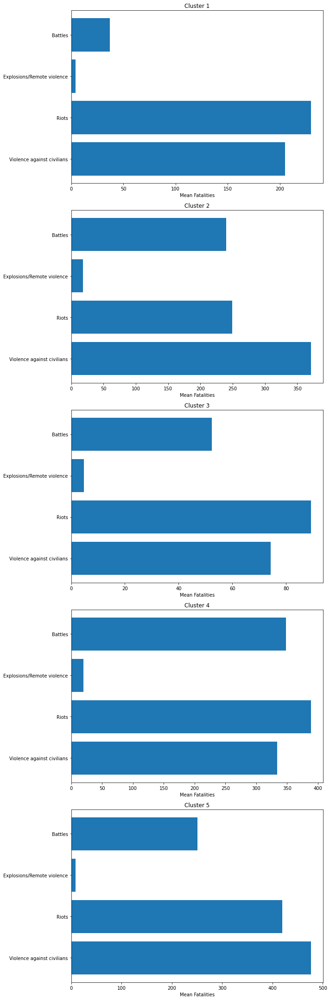

KeyError: ignored

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# read data
data = df

# filter actors with less than 100 occurrences
actors_to_keep = data['actor1'].value_counts()[data['actor1'].value_counts() >= 100].index.tolist()
data = data[data['actor1'].isin(actors_to_keep)]

# create a pivot table of fatality counts by admin1 and event_type
pivot_data = pd.pivot_table(data, values='fatalities', index=['admin1'], columns=['event_type'], aggfunc=np.sum, fill_value=0)

# perform KMeans clustering
kmeans = KMeans(n_clusters=5, random_state=42).fit(pivot_data)

# assign cluster labels to each admin1
pivot_data['cluster'] = kmeans.labels_
#pivot_data = pd.pivot_table(data, index=['admin1', 'event_type'], columns='cluster', values='fatalities', aggfunc='mean')


# calculate the mean fatalities by cluster
cluster_fatalities = pivot_data.groupby(['cluster']).mean()

# visualize the clusters
fig, axs = plt.subplots(nrows=len(cluster_fatalities), figsize=(10,30))
for i, (idx, row) in enumerate(cluster_fatalities.iterrows()):
    ax = axs[i]
    ax.barh(range(len(row)), row)
    ax.set_yticks(range(len(row)))
    ax.set_yticklabels(row.index)
    ax.invert_yaxis()
    ax.set_xlabel('Mean Fatalities')
    ax.set_title(f'Cluster {idx+1}')
plt.tight_layout()
plt.show()

# find event types for each cluster
event_type_clusters = pd.concat([pivot_data['cluster'], pd.get_dummies(pivot_data['event_type'])], axis=1)
event_type_clusters = event_type_clusters.groupby(['cluster']).sum()
event_type_clusters = event_type_clusters.div(event_type_clusters.sum(axis=1), axis=0)
event_type_clusters = event_type_clusters.apply(lambda x: x.sort_values(ascending=False), axis=1)

# visualize the event types for each cluster
fig, axs = plt.subplots(nrows=len(event_type_clusters), figsize=(10,30))
for i, (idx, row) in enumerate(event_type_clusters.iterrows()):
    ax = axs[i]
    ax.bar(range(len(row)), row)
    ax.set_yticks(range(len(row)))
    ax.set_yticklabels(row.index)
    ax.invert_yaxis()
    ax.set_xlabel('Percentage')
    ax.set_title(f'Cluster {idx+1}')
plt.tight_layout()
plt.show()


In [ ]:
pivot_data

event_type,Battles,Explosions/Remote violence,Riots,Violence against civilians,cluster
admin1,,,,,
Barisal,27,0,69,55,2
Chittagong,251,9,420,477,4
Dhaka,348,20,389,334,3
Khulna,267,19,256,420,1
Mymensingh,35,0,67,70,2
Rajshahi,213,17,243,323,1
Rangpur,37,4,230,205,0
Sylhet,95,14,132,98,2


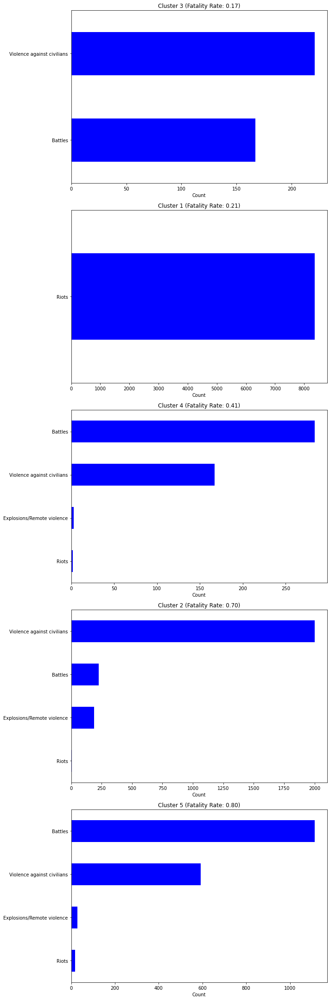

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Read in the data
data = df

# Define the categorical columns
categorical_cols = ['admin1', 'event_type', 'actor1']

# Create dummy variables for the categorical columns
dummy_data = pd.get_dummies(data[categorical_cols])

# Scale the data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaled_data = scaler.fit_transform(dummy_data)

# Perform KMeans clustering
kmeans = KMeans(n_clusters=5)
kmeans.fit(scaled_data)

# Add the cluster labels to the original data
data['cluster'] = kmeans.labels_

# Calculate the average fatality rate for each cluster
cluster_fatalities = data.groupby('cluster')['fatalities'].mean()

# Sort the clusters by fatality rate
sorted_clusters = np.argsort(cluster_fatalities)

# Loop over each cluster and plot a bar chart showing the event types
fig, axs = plt.subplots(nrows=len(cluster_fatalities), figsize=(10, 30))

for i, cluster_num in enumerate(sorted_clusters):
    # Get the rows belonging to this cluster
    cluster_data = data[data['cluster'] == cluster_num]
    # Count the number of occurrences of each event type within the cluster
    event_type_counts = cluster_data['event_type'].value_counts()
    # Plot a bar chart
    event_type_counts.plot(kind='barh', ax=axs[i], color='blue')
    # Set the title and y-axis label
    axs[i].set_title(f'Cluster {cluster_num+1} (Fatality Rate: {cluster_fatalities[cluster_num]:.2f})')
    axs[i].set_xlabel('Count')
    # Invert the y-axis so that the most frequent event type is at the top
    axs[i].invert_yaxis()

plt.tight_layout()
plt.show()


# Founded the causes of fatalities in each cluster.

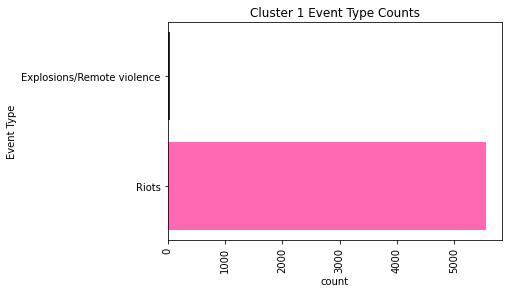

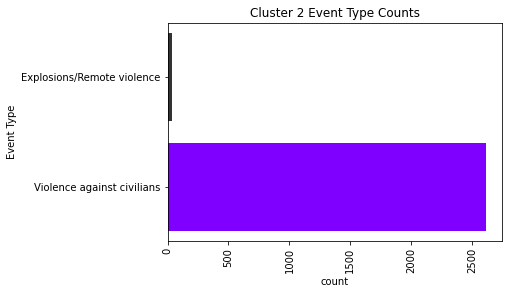

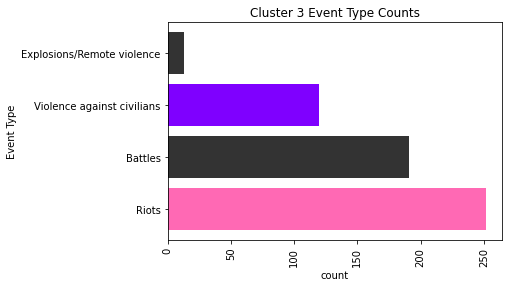

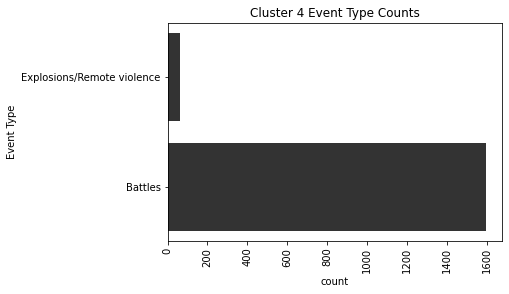

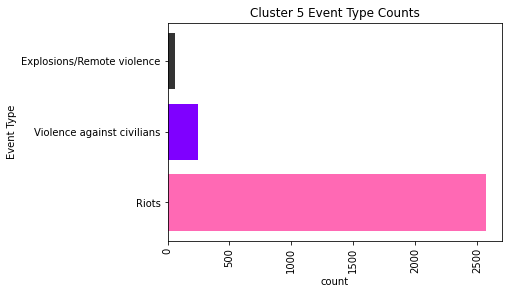

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# load data
data = df

# select relevant columns
data = data[['admin1', 'event_type', 'fatalities']]

# one-hot encode categorical columns
data = pd.get_dummies(data, columns=['admin1', 'event_type'])

# standardize numeric columns
numeric_cols = ['fatalities']
data[numeric_cols] = (data[numeric_cols] - data[numeric_cols].mean()) / data[numeric_cols].std()

# perform clustering
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(data)

# add cluster labels to original dataframe
data['cluster'] = kmeans.labels_


# Define colors for each event type
colors = {
    'Protests': '#1f77b4',
    'Riots': '#FF69B4',
    'Violence against civilians': '#7F00FF',
    'Battle-No change of territory': '#d12728',
    'Remote violence': '#9467bd'
}

# plot bar chart for each cluster
for i in range(num_clusters):
    cluster_data = df[data['cluster'] == i]
    event_type_counts = cluster_data['event_type'].value_counts()
    plt.figure()
    plt.barh(event_type_counts.index, event_type_counts.values,color=[colors.get(e, '#333333') for e in event_type_counts.index])
    plt.title(f'Cluster {i+1} Event Type Counts')
    plt.xlabel('count')
    plt.ylabel('Event Type')
    plt.xticks(rotation=90)
    plt.show()




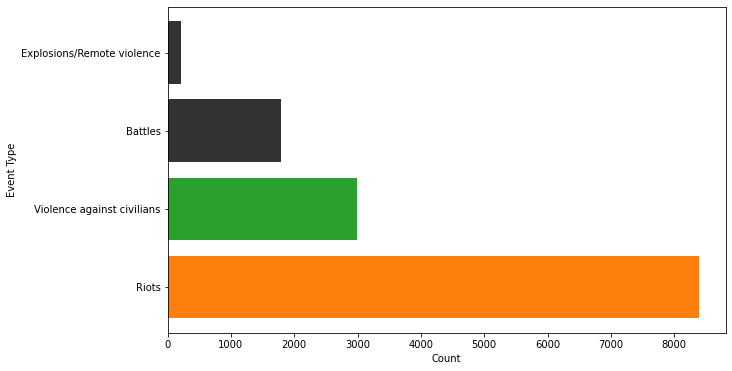

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load data
data = df

# Group data by event type
event_type_counts = data['event_type'].value_counts()

# Define colors for each event type
colors = {
    'Protests': '#1f77b4',
    'Riots': '#ff7f0e',
    'Violence against civilians': '#2ca02c',
    'Battle-No change of territory': '#d62728',
    'Remote violence': '#9467bd'
}

# Create bar chart
fig, ax = plt.subplots(figsize=(10, 6))

ax.barh(event_type_counts.index, event_type_counts.values, color=[colors.get(e, '#333333') for e in event_type_counts.index])

ax.set_xlabel('Count')
ax.set_ylabel('Event Type')

plt.show()


# Finding actors involved in the clusters with highest event_types

In [ ]:
df_new = df

<ipython-input-164-9f06b5301e81>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['actor1'] = np.where(data['actor1'].isin(actor_count[actor_count < 124].index), 'other', df['actor1'])
<ipython-input-164-9f06b5301e81>:52: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  plt.tight_layout()


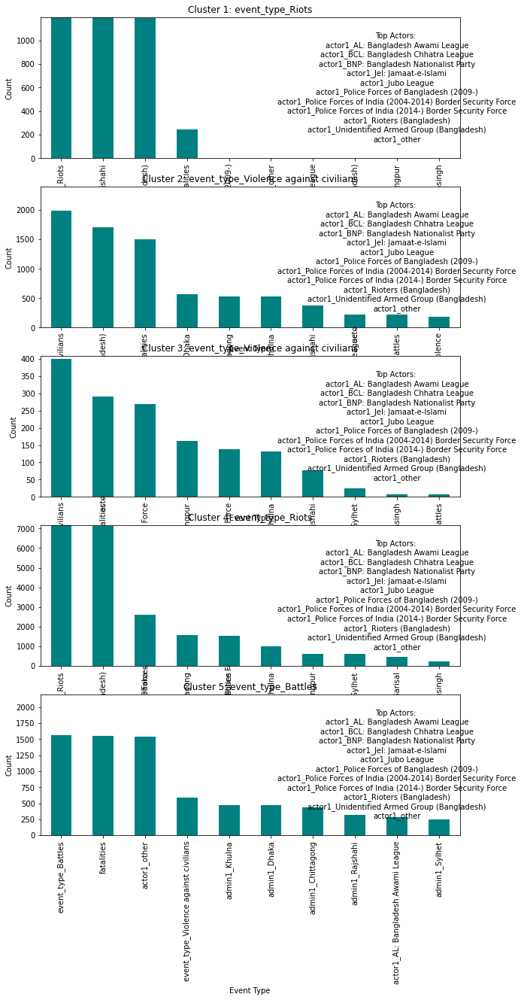

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# load data
data = df

# select relevant columns
data = data[['admin1', 'event_type', 'fatalities','actor1']]
# filter actors with count less than 124 and update them as "other"
actor_count = df['actor1'].value_counts()
data['actor1'] = np.where(data['actor1'].isin(actor_count[actor_count < 124].index), 'other', df['actor1'])


# Convert categorical columns to dummy variables
data = pd.get_dummies(data, columns=['event_type', 'actor1', 'admin1'])

# Scale data
scaler = StandardScaler()
X = scaler.fit_transform(data)

# Cluster data into 5 groups based on area and fatalities
kmeans = KMeans(n_clusters=5)
kmeans.fit(X)
data['cluster'] = kmeans.predict(X)

# Get the max count of event type for each cluster
max_count = []
for i in range(5):
    temp_data = data[data['cluster'] == i].drop('cluster', axis=1)
    max_count.append(temp_data.sum().idxmax())

# Get the actors involved in each cluster for the max count of event type
actors_in_cluster = {}
for i in range(5):
    temp_data = data[data['cluster'] == i].drop('cluster', axis=1)
    actors_in_cluster[i] = list(temp_data[temp_data[max_count[i]] == 1].filter(like='actor1_').columns)

# Visualize the results
fig, axs = plt.subplots(5, 1, figsize=(10,20))
for i in range(5):
    temp_data = data[data['cluster'] == i].drop('cluster', axis=1)
    temp_data.sum().sort_values(ascending=False)[:10].plot(kind='bar', ax=axs[i], color='teal')
    axs[i].set_title(f'Cluster {i+1}: {max_count[i]}')
    axs[i].set_xlabel('Event Type')
    axs[i].set_ylabel('Count')
    axs[i].set_ylim([0, temp_data.shape[0]])
    actors_str = '\n'.join(actors_in_cluster[i])
    axs[i].text(0.85, 0.5, f'Top Actors: \n{actors_str}', horizontalalignment='center', verticalalignment='center', transform=axs[i].transAxes, fontsize=10)
plt.tight_layout()
plt.show()


In [ ]:
df['actor1'].value_counts()[0:10]

Rioters (Bangladesh)                                        8332
Unidentified Armed Group (Bangladesh)                       1714
AL: Bangladesh Awami League                                  456
BCL: Bangladesh Chhatra League                               388
Police Forces of India (2004-2014) Border Security Force     270
Police Forces of Bangladesh (2009-)                          168
Police Forces of India (2014-) Border Security Force         139
BNP: Bangladesh Nationalist Party                            129
Jubo League                                                  126
JeI: Jamaat-e-Islami                                         124
Name: actor1, dtype: int64

In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# load data
data = df

# select relevant columns
data = data[['actor1', 'admin1', 'event_type', 'fatalities']]

# filter actors having count less than 124 to "other"
counts = data['actor1'].value_counts()
data['actor1'] = data['actor1'].apply(lambda x: 'other' if counts[x] < 124 else x)

# one-hot encode categorical columns
data = pd.get_dummies(data, columns=['admin1', 'event_type', 'actor1'])

# standardize the data
scaler = StandardScaler()
X = scaler.fit_transform(data)

# cluster the data
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)
labels = kmeans.labels_

# count actors involved in each cluster
actors_in_cluster = []
for i in range(5):
    temp_data = data[labels == i]
    max_count = temp_data.sum().nlargest(10).index
    actors_in_cluster.append((i, temp_data[max_count].sum().values))

# print the count of actors involved in each cluster
for cluster, counts in actors_in_cluster:
    print(f"Cluster {cluster+1}:\n{counts}\n")


<ipython-input-165-5cea315446a1>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['actor1'] = data['actor1'].apply(lambda x: 'other' if counts[x] < 124 else x)


Cluster 1:
[8369 8331 2628 1778 1576 1194  995  634  621  483]

Cluster 2:
[1570 1566 1537  593  470  469  433  327  284  247]

Cluster 3:
[1990 1713 1505  564  529  528  380  221  217  189]

Cluster 4:
[270 263 180 100  98  49  17   6   2   2]

Cluster 5:
[139 138 111  64  32  28   8   5   1   1]



<ipython-input-176-dccd49c8fcf9>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['actor1'] = data['actor1'].apply(lambda x: 'other' if counts[x] < 200 else x)


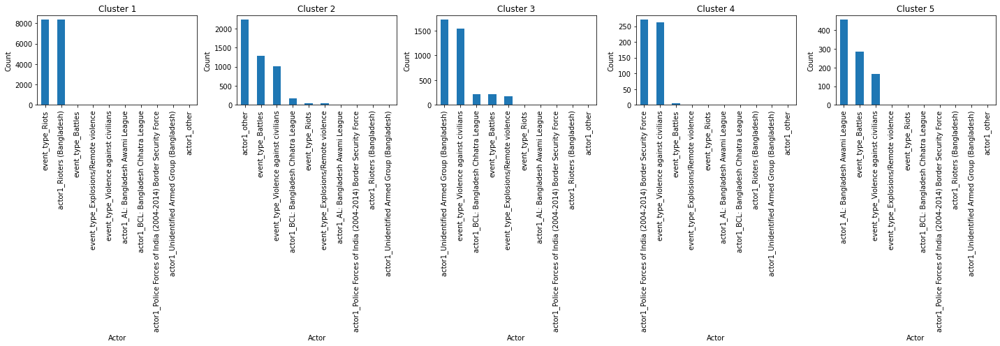

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
%matplotlib inline

# Load data
data = df

# Select relevant columns
cols = ['event_type', 'actor1']
data = data[cols]


# filter actors having count less than 124 to "other"
counts = data['actor1'].value_counts()
data['actor1'] = data['actor1'].apply(lambda x: 'other' if counts[x] < 200 else x)

# One-hot encode categorical columns
data = pd.get_dummies(data)

# Scale the data
scaler = StandardScaler()
X = scaler.fit_transform(data)

# Cluster the data
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)
labels = kmeans.labels_

# Count the number of actors in each cluster
actors_in_cluster = {}
for i in range(5):
    temp_data = data[labels == i]
    actor_counts = temp_data.sum(axis=0)
    actor_counts = actor_counts.sort_values(ascending=False)
    actors_in_cluster[i] = actor_counts

# Visualize the actor counts for each cluster
fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(20, 7))
for i in range(5):
    ax = axes[i]
    actor_counts = actors_in_cluster[i]
    actor_counts.plot(kind='bar', ax=ax, title=f'Cluster {i+1}')
    ax.set_xlabel('Actor')
    ax.set_ylabel('Count')
plt.tight_layout()
plt.show()


# Which Month of the year have most fatality rate

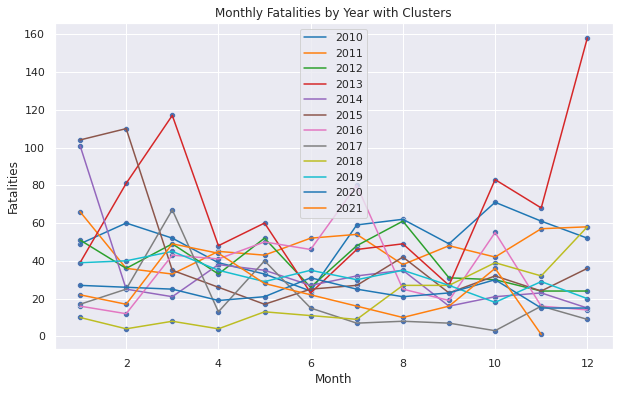

In [ ]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns

# load data
data = df

# # extract year and month from date column
# data['date'] = pd.to_datetime(data['date'])
# data['year'] = data['date'].dt.year
# data['month'] = data['date'].dt.month

# group by year and month and sum up fatalities
fatalities_by_month = data.groupby(['year', 'month'])['fatalities'].sum().reset_index()

# use KMeans clustering with k=3
X = fatalities_by_month[['month', 'fatalities']]
kmeans = KMeans(n_clusters=3, random_state=42).fit(X)
fatalities_by_month['cluster'] = kmeans.labels_

# plot the results
sns.set(style='darkgrid')
fig, ax = plt.subplots(figsize=(10, 6))
sns.lineplot(x='month', y='fatalities', hue='year', data=fatalities_by_month, ax=ax, palette='tab10')
sns.scatterplot(x='month', y='fatalities', hue='cluster', data=fatalities_by_month, ax=ax, palette='Set1')
plt.title('Monthly Fatalities by Year with Clusters')
plt.xlabel('Month')
plt.ylabel('Fatalities')
plt.show()


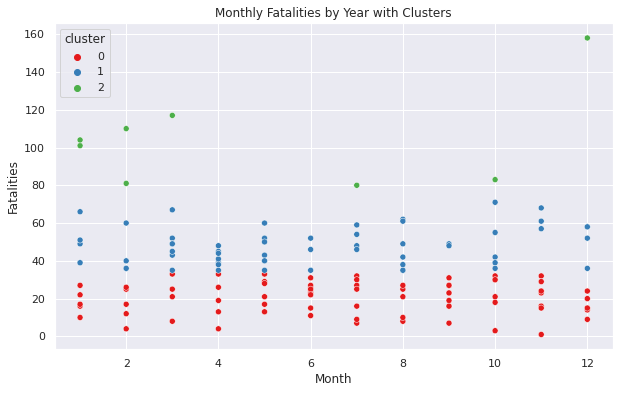

In [ ]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns

# load data
data = df

# # extract year and month from date column
# data['date'] = pd.to_datetime(data['date'])
# data['year'] = data['date'].dt.year
# data['month'] = data['date'].dt.month

# group by year and month and sum up fatalities
fatalities_by_month = data.groupby(['year', 'month'])['fatalities'].sum().reset_index()

# use KMeans clustering with k=3
X = fatalities_by_month[['month', 'fatalities']]
kmeans = KMeans(n_clusters=3, random_state=42).fit(X)
fatalities_by_month['cluster'] = kmeans.labels_

# plot the results
sns.set(style='darkgrid')
fig, ax = plt.subplots(figsize=(10, 6))
#sns.lineplot(x='month', y='fatalities', hue='year', data=fatalities_by_month, ax=ax, palette='tab10')
sns.scatterplot(x='month', y='fatalities', hue='cluster', data=fatalities_by_month, ax=ax, palette='Set1')
plt.title('Monthly Fatalities by Year with Clusters')
plt.xlabel('Month')
plt.ylabel('Fatalities')
plt.show()


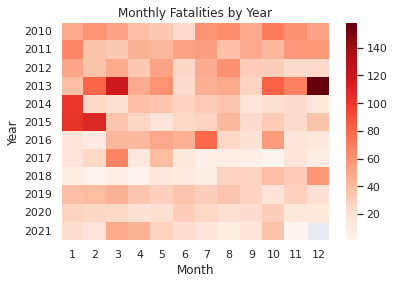

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load data
data = df

# Create a pivot table to aggregate the fatalities by year and month
data_pivot = pd.pivot_table(data, values='fatalities', index='year', columns='month', aggfunc=sum)

# Create a heatmap using seaborn
sns.heatmap(data_pivot, cmap='Reds')

# Set plot title and axis labels
plt.title('Monthly Fatalities by Year')
plt.xlabel('Month')
plt.ylabel('Year')

# Display the plot
plt.show()


# visualize a map of bangladesh where it will indicate the area with high fatality

In [ ]:
import folium

# Load data
data = df

# Filter data to get only the columns of interest
filtered_data = data[['latitude', 'longitude', 'fatalities']]

# Get the mean fatalities by location
mean_fatality_by_location = filtered_data.groupby(['latitude', 'longitude']).mean().reset_index()

# Initialize the map at the center of Bangladesh
map_bangladesh = folium.Map(location=[23.8103, 90.4125], zoom_start=7)

# Add markers for each location with high fatality
for index, row in mean_fatality_by_location.iterrows():
    lat = row['latitude']
    lon = row['longitude']
    fatalities = row['fatalities']

    # Set the marker color based on fatality rate
    if fatalities >= 500:
        color = 'red'
    # elif fatalities >= 300:
    #     color = 'orange'
    else:
        color = 'yellow'

    # Add the marker to the map
    folium.Marker(location=[lat, lon], icon=folium.Icon(color=color)).add_to(map_bangladesh)

# Display the map
map_bangladesh


<ipython-input-17-506c49333243>:30: UserWarning: color argument of Icon should be one of: {'darkred', 'darkgreen', 'pink', 'beige', 'lightgray', 'black', 'white', 'cadetblue', 'green', 'blue', 'purple', 'gray', 'lightgreen', 'red', 'lightred', 'darkblue', 'orange', 'darkpurple', 'lightblue'}.
  folium.Marker(location=[lat, lon], icon=folium.Icon(color=color)).add_to(map_bangladesh)


In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# load data
data = df

# extract columns of interest
X = data[['latitude', 'longitude', 'fatalities']]

# normalize the data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = scaler.fit_transform(X)

# perform clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# add cluster labels to dataframe
data['cluster'] = kmeans.labels_

# visualize the clusters on a map
import folium
map = folium.Map(location=[23.8103, 90.4125], zoom_start=7)

colors = ['red', 'blue', 'green', 'purple', 'orange']

for lat, lon, cluster, label in zip(data['latitude'], data['longitude'], data['cluster'], kmeans.labels_):
    folium.CircleMarker(
        location=[lat, lon],
        radius=5,
        popup=f"Cluster: {label}",
        color=colors[cluster],
        fill=True,
        fill_color=colors[cluster]
    ).add_to(map)

map


<ipython-input-20-17564d5ff0f9>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['cluster'] = labels


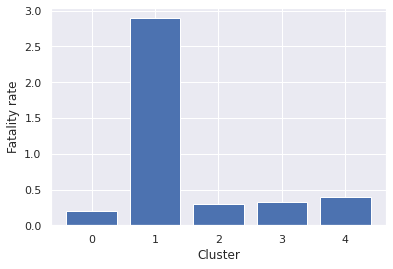

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# load the data
data = df

# filter for only relevant columns
data = data[['latitude', 'longitude', 'fatalities']]

# scale the data
scaler = StandardScaler()
X = scaler.fit_transform(data)

# cluster the data
kmeans = KMeans(n_clusters=5, random_state=0).fit(X)
labels = kmeans.labels_

# add the labels to the original dataframe
data['cluster'] = labels

# calculate the fatality rate for each cluster
fatality_rates = data.groupby('cluster')['fatalities'].sum() / data.groupby('cluster')['fatalities'].count()

# plot the fatality rates
plt.bar(fatality_rates.index, fatality_rates.values)
plt.xlabel('Cluster')
plt.ylabel('Fatality rate')
plt.show()
# cluster colors colors = ['red', 'blue', 'green', 'purple', 'orange']

In [ ]:
import pandas as pd
import folium
from sklearn.cluster import KMeans
from folium.plugins import MarkerCluster

# Load the dataset
data = df

# Select the latitude, longitude, and fatalities columns
X = data[['latitude', 'longitude', 'fatalities']]

# Normalize the data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Cluster the data into 5 clusters
kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(X_scaled)

# Add the cluster labels to the dataframe
data['cluster'] = clusters

# Create a map centered on Bangladesh
map = folium.Map(location=[23.8103, 90.4125], zoom_start=7)

# Create a marker cluster layer for each cluster
for cluster in data['cluster'].unique():
    # Filter the data for the current cluster
    clustered_data = data[data['cluster'] == cluster]
    # Create a marker cluster layer for the current cluster
    marker_cluster = MarkerCluster().add_to(map)
    # Add circle markers to the marker cluster layer for each point in the current cluster
    for i, row in clustered_data.iterrows():
        folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=10,
                            color=None, fill=True, fill_color='red').add_to(marker_cluster)

# Display the map
map


<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=b3a63533-b289-453b-964c-81d5b691aecc' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>